# Project exam - Massimini A., Moschella C.
## Simulation of Vicsek model with large-scale collective oscillations 

In the following document we simulate the model from the paper "Weak synchronization and large-scale collective
oscillation in dense bacterial suspensions", [here](https://www.nature.com/articles/nature20817) the link to the article.
The systems of SDEs in which we are interested is 

$dx_i=v_0(\cos(\theta_i),\sin(\theta_i))dt$

$d\theta_i = \omega_i dt + \frac{k_\theta}{N} \sum_{j=1,\ |x_i-x_j| < d_0}^N K(|x_i-x_j|)\sin(\theta_j - \theta_i) dt + \sqrt{2D_\theta} dB_t $

$d\omega_i = -\frac{\omega_i}{\tau}dt + \frac{k_\omega}{N} \sum_{j=1, \ |x_i-x_j| < d_0}^N K(|x_i-x_j|)(\omega_j - \omega_i) dt + \sqrt{2D_\omega} dB_t $

In this code we decided to use period boundary condition.


In [1]:
using DifferentialEquations, Plots, Interact, UnPack, Distributions # libraries

WebIO._IJuliaInit()

In [2]:
it=1 # Auxiliary variable (to avoid overwriting on output files)
it=it+1
N=100 # Total number of individuals
indexN = 4*N
invN=1/N
k_1=30  # factor multiplying the interaction potential
k_2=40  # factor multiplying the interaction potential (in velocity)
τ=10  # factor dividing the angular velocity in the ODE for \theta
end_time = 30 # Final time for the simulation
noise_1 = 0.5 
noise_2 = 0.5

# Parameters of the model [R, v_0, L] 
#                         [Radius of interaction, speed, domain size]
parms = (R=0.8,v₀=1,L=6, N, indexN, k_1, k_2, τ)

println("Parameters")
println("N=$N")
println("Final time = $end_time")
println("R=$(parms[1])")
println("v₀=$(parms[2])")
println("L=$(parms[3])")

Parameters
N=100
Final time = 30
R=0.8
v₀=1
L=6


### Auxiliary functions

In [3]:
function normv(u1,u2) #||.||^2 
   return (u1^2+u2^2)
end

function distance(X,Y)
    return √sum(((X-Y).*(X-Y)))
end

function PotGradient(r,p) # The gradient of the interaction potential U(r) w.r.t r
    return sin(r)
end

function neighbours(X,Y,p) #This function evaluate the distance between two particles (considering also the boundary conditions) and it says "true" if two particles are close enough to interact. Otherweis it says "false"
     @unpack R,L = p
    if distance(X,Y)<R ||distance(X,[Y[1]-L,Y[2]])< R || distance(Y,[X[1]-L,X[2]])< R ||distance(X,[Y[1],Y[2]-L])< R|| distance(Y,[X[1],X[2]-L])< R || distance([X[1]-L,X[2]-L],Y)<R || distance([Y[1]-L,Y[2]-L],X)<R
        return true #if particles are close enough (<R) to interact
    end
    return false #if they don't interact (≥ R)
end

#Periodic boundary conditions in space: a particle that exit the domain, is insert again in a symmetric way
function velocity_boundaries_x!(u,index, p) #for the first component x of the position
   #update spatial variable
     @unpack L = p
    if u[index]>L; u[index]=u[index]-L; end
    if u[index]<0; u[index]=u[index]+L; end
    return cos(u[index+2])
end

function velocity_boundaries_y!(u,index,p) #for the second component y of the position
   #update spatial variable
     @unpack L = p
    if u[index+1]>L; u[index+1]=u[index+1]-L; end
    if u[index+1]<0; u[index+1]=u[index+1]+L; end
    return sin(u[index+2])
end

#Potential in the angle's equation
function Potential(u,index,p) 
     @unpack R,L = p
    pot =0
    #first, we apply the boundary conditions
    if u[index]>L; u[index]=u[index]-L; end
    if u[index]<0; u[index]=u[index]+L; end
    if u[index+1]>L; u[index+1]=u[index+1]-L; end
    if u[index+1]<0; u[index+1]=u[index+1]+L; end
    coord =[u[index],u[index+1]] # =Xᵢ (position of particle 'i')
    for j=1:4:indexN # run over all the particles
        if j!=index
            coordj = [u[j],u[j+1]] # =Xⱼ (position of particle 'j')
            if neighbours(coord,coordj,p)
                pot = pot + PotGradient(u[index+2]-u[j+2],p)  #we are summing on j the function sin(θ_i - θ_j)
            end
        end
    end
    return pot
end

#Potential in the angular velocity's equation
function Potential_ang_vel(u,index,p) 
     @unpack R,L = p
    pot =0
    #first, we apply the boundary conditions
    if u[index]>L; u[index]=u[index]-L; end
    if u[index]<0; u[index]=u[index]+L; end
    if u[index+1]>L; u[index+1]=u[index+1]-L; end
    if u[index+1]<0; u[index+1]=u[index+1]+L; end
    coord =[u[index],u[index+1]] # =Xᵢ (position of particle 'i')
    for j=1:4:indexN # run over all the particles
        if j!=index
            coordj = [u[j],u[j+1]] # =Xⱼ (position of particle 'j')
            if neighbours(coord,coordj,p)
                pot = pot + (u[j+3]-u[index+3])  #we are summing on j the function (ω_j - ω_i)
            end
        end
    end
    return pot
end


Potential_ang_vel (generic function with 1 method)

### ODE

In [4]:
function Vicsek_model!(du,u,p,t)
     @unpack R, v₀,L,indexN,k_1, k_2, τ = p
    pot_aux =0.0
    for i=1:4:indexN
        
        # dX_i/dt = V_i
        du[i] = v₀*velocity_boundaries_x!(u,i,p)#cos(u[i+2])   
        du[i+1] = v₀*velocity_boundaries_y!(u,i,p)# sin(u[i+2]) 
        
        pot_aux = (k_1*invN).*Potential(u,i,p)  # κ *∇ᵢU/N (Xᵢ)
        # dθ_i/dt
        du[i+2] = u[i+3] -pot_aux # there is "-" in front of pot_aux, since we need to consider sin(θ_j-θ_i) = - sin(θ_i - θ_j)
        
        # dω_i/dt
        du[i+3] = - u[i+3]/τ + (k_2*invN).*Potential_ang_vel(u,i,p)
        
    end
end

Vicsek_model! (generic function with 1 method)

### Initial data

In [5]:
# initial data 
u_init=rand(4*N)*parms[3]
ω_init=-[1 for i in 1:N]+ 8*rand(N)
j=1
for i=1:4:indexN
    u_init[i+2]=u_init[i+2]*2π/parms[3]
    u_init[i+3]=ω_init[j] #u_init[i+3]/parms[3]
    j=j+1
end


### Solve the system

In [6]:
#solve the system
probCS = ODEProblem(Vicsek_model!,u_init,(0.0,end_time),parms)

ODEProblem with uType Vector{Float64} and tType Float64. In-place: true
timespan: (0.0, 30.0)
u0: 400-element Vector{Float64}:
  3.449312079422792
  3.40452778100547
  0.16055096423969956
  3.659605371134327
  4.970531761241552
  4.077356670298168
  4.76619994644445
  3.704911928137462
  2.789681858113247
  1.9106209414982376
  2.2216519671128565
  6.449058427893825
  2.8876081869894987
  ⋮
  1.520220900425229
  0.503971516191446
  3.950953569261074
 -0.5601218156157222
  3.5133760734070805
  5.422461065849258
  2.2776144300944607
  2.50170336185469
  1.3036779809325123
  4.5423418869660495
  0.39116642175505273
  1.3986646448325883

In [7]:
time_execution = @elapsed solCS =solve(probCS)

93.8885292

In [8]:
println("Minutes taken to solve the system")
time_execution/60

Minutes taken to solve the system


1.5648088199999999

### Plot

┌ Info: Saved animation to 
│   fn = C:\Users\Moschella\OneDrive\Desktop\Modeling Interacting Particles - Julia\Project - Exam\animationVicsek 2 N=100 R=0.8 v₀=1 L=6.gif
└ @ Plots C:\Users\Moschella\.julia\packages\Plots\8ouqB\src\animation.jl:114


Plots.AnimatedGif("C:\\Users\\Moschella\\OneDrive\\Desktop\\Modeling Interacting Particles - Julia\\Project - Exam\\animationVicsek 2 N=100 R=0.8 v₀=1 L=6.gif")
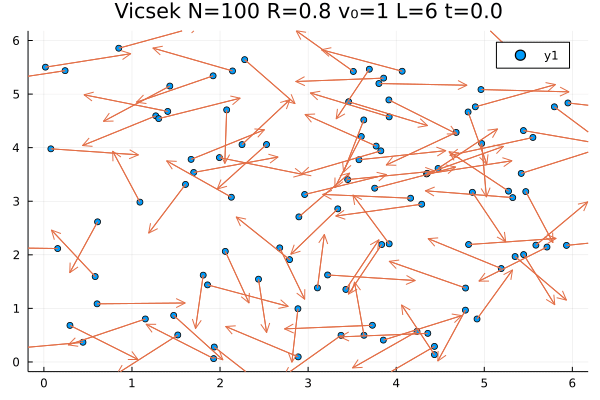

In [9]:
#plot the system
L=parms[3]
anim = @animate for time ∈ 0.0:0.1:end_time
    s = solCS(time)
    x=[]
    y=[]
    u=[]
    v=[]
    for i=1:4:indexN
        append!(x,s[i])
        append!(y,s[i+1])
        append!(u,cos(s[i+2]))
        append!(v,sin(s[i+2]))
    end
    fig=scatter(x,y,xlims=[0,L],ylims=[0,L]) # I fixed the axis, otherwise, erase xlims and ylims
    quiver!(x,y,quiver=(u,v))
    title!("Vicsek N=$N R=$(parms[1]) v₀=$(parms[2]) L=$(parms[3]) t=$time")

end
    gif(anim, "animationVicsek $it N=$N R=$(parms[1]) v₀=$(parms[2]) L=$(parms[3]).gif", fps = 10)



### Adding noise 

┌ Info: Saved animation to 
│   fn = C:\Users\Moschella\OneDrive\Desktop\Modeling Interacting Particles - Julia\Project - Exam\animationVicsek 2 N=100 R=0.8 v₀=1 L=6 +Noise.gif
└ @ Plots C:\Users\Moschella\.julia\packages\Plots\8ouqB\src\animation.jl:114


Plots.AnimatedGif("C:\\Users\\Moschella\\OneDrive\\Desktop\\Modeling Interacting Particles - Julia\\Project - Exam\\animationVicsek 2 N=100 R=0.8 v₀=1 L=6 +Noise.gif")
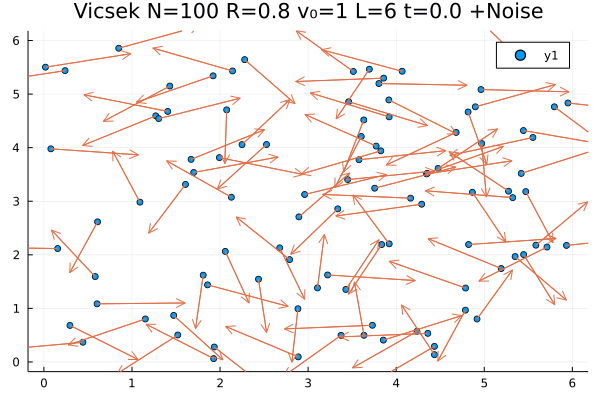

In [13]:
# WITH NOISE
end_time = 30
function σ_Vicsek!(du,u,p,t)
    @unpack noise1, noise2, indexN = p
    for i=1:4:indexN
        du[i]=0.0
        du[i+1] =0.0  # dX_i/dt = V_i (second component)
        du[i+2]= noise1
        du[i+3] = noise2
    end
end

sde_parms = (; parms..., noise1 = rand(Uniform(-noise_1,noise_1)) , noise2=rand(Uniform(-noise_2,noise_2)))
prob = SDEProblem(Vicsek_model!,σ_Vicsek!,u_init,(0.0,end_time), sde_parms )

time_execution2 = @elapsed sol_diff_V= solve(prob, SOSRI())
L=parms[3]
anim = @animate for time ∈ 0.0:0.1:end_time
      s = sol_diff_V(time)
    x=[]
    y=[]
    u=[]
    v=[]
    for i=1:4:indexN
        append!(x,s[i])
        append!(y,s[i+1])
        append!(u,cos(s[i+2]))
        append!(v,sin(s[i+2]))
    end
    fig=scatter(x,y,xlims=[0,L],ylims=[0,L]) # I fixed the axis, otherwise, erase xlims and ylims
    quiver!(x,y,quiver=(u,v))
    title!("Vicsek N=$N R=$(parms[1]) v₀=$(parms[2]) L=$(parms[3]) t=$time +Noise")

end
    gif(anim, "animationVicsek $it N=$N R=$(parms[1]) v₀=$(parms[2]) L=$(parms[3]) +Noise.gif", fps = 10)